# Project Description

### The goal of this project is to explore ways to attract and retain high-income and highly educated individuals in Helsinki.

### From a business perspective, success could be reflected in the development and growth of public services across different areas of Helsinki. These services include shops, daycare centers, schools, healthcare facilities, and recreational opportunities. Enhancing these services can improve residents’ daily lives by offering greater convenience, comfort, and better living conditions.

### In the ideal scenario, the insights and solutions identified in this project will support Helsinki’s strategic urban development and motivate the target group to either relocate to or remain in the city long term.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path1 = '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/asuntokuntien_koulutus.xlsx'
path2 = '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/asuntokuntien_tulot.xlsx'
path3 = '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/väkiluku_aluettain.xlsx'
path4 = '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/Helsinki_alueittain_2019.xlsx'
path5 = '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/Helsinki_alueittain_2019 (1).xlsx'
path6 = '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/finland-postal-codes.geojson'

asuntokuntien_koulutus = pd.read_excel(path1, header=[0, 1, 2, 3])
asuntokuntien_tulot = pd.read_excel(path2, header=[0, 1, 2, 3])
väkiluku_aluettain = pd.read_excel(path3, header=[0, 1, 2])
palvelut_aluettain = pd.read_excel(path5, header=list(range(1,86)))

FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/Helsinki_alueittain_2019 (1).xlsx'

In [ ]:
print(asuntokuntien_koulutus.columns[4][3])
print(asuntokuntien_tulot.columns[1][3])
print(väkiluku_aluettain.columns[0][2])
print(palvelut_aluettain.columns[19])

# Preparation
### This code extracts and combines regional education, income, and population data from multiple datasets into a single list of dictionaries (`data_dict`).

### **Step 1** : Extract education data by region from `asuntokuntien_koulutus`

### **Step 2**: Merge average and median income data from `asuntokuntien_tulot`

### **Step 3**: Add population figures from `väkiluku_aluettain`

### **Step 4**: Calculate the percentage of educated individuals per region

### The final output is a structured dataset with each region's:
- Total educated individuals
- Average and median income
- Population
- Educated population percentage

In [ ]:
koulutus_len = len(asuntokuntien_koulutus.columns)

data_dict=[]
i=4
while i <= koulutus_len:
  # Region
  region = asuntokuntien_koulutus.columns[i][0]
  # Education
  education = 0 if ( not isinstance(asuntokuntien_koulutus.columns[i][3], (int, float, complex)) or not isinstance(asuntokuntien_koulutus.columns[i+5][3], (int, float, complex)) ) else asuntokuntien_koulutus.columns[i][3]+asuntokuntien_koulutus.columns[i+5][3]

  dict1 = {"Region": region,"Educated": education}
  data_dict.append(dict1)
  i+=10

salary_len = len(asuntokuntien_tulot.columns)
data_dict_len = len(data_dict)

j = 0
k = 0


while j < salary_len:
  alone_average =  0 if not isinstance(asuntokuntien_tulot.columns[j][3], (int, float, complex)) else asuntokuntien_tulot.columns[j][3]
  alone_median =  0 if not isinstance(asuntokuntien_tulot.columns[j+1][3], (int, float, complex)) else asuntokuntien_tulot.columns[j+1][3]
  pair_average =  0 if not isinstance(asuntokuntien_tulot.columns[j+2][3], (int, float, complex)) else asuntokuntien_tulot.columns[j+2][3]/2
  pair_median =  0 if not isinstance(asuntokuntien_tulot.columns[j+3][3], (int, float, complex)) else asuntokuntien_tulot.columns[j+3][3]/2
  pair_child_average =  0 if not isinstance(asuntokuntien_tulot.columns[j+4][3], (int, float, complex)) else asuntokuntien_tulot.columns[j+4][3]/2
  pair_child_median =  0 if not isinstance(asuntokuntien_tulot.columns[j+5][3], (int, float, complex)) else asuntokuntien_tulot.columns[j+5][3]/2
  alone_child_average =  0 if not isinstance(asuntokuntien_tulot.columns[j+6][3], (int, float, complex)) else asuntokuntien_tulot.columns[j+6][3]
  alone_child_median =  0 if not isinstance(asuntokuntien_tulot.columns[j+7][3], (int, float, complex)) else asuntokuntien_tulot.columns[j+7][3]

  average_salary = (alone_average + pair_average + pair_child_average + alone_child_average)/4
  median_salary = (alone_median + pair_median + pair_child_median + alone_child_median)/4

  data_dict[k]["Average_salary"] = average_salary
  data_dict[k]["Median_salary"] = median_salary

  j+=8
  k+=1

y = 0
z = 0
population_len = len(väkiluku_aluettain.columns)


while y < population_len:
  population = 0 if not isinstance(väkiluku_aluettain.columns[y][2], (int, float, complex)) else väkiluku_aluettain.columns[y][2]
  educated_percentage = [i["Educated"] / population if population > 0 else 0 for i in data_dict]

  data_dict[z]["Population"] = population
  data_dict[z]["Educated_Percentage"] = educated_percentage[z]

  y += 1
  z += 1

print(data_dict)

In [ ]:
data_dict = [d for d in data_dict if d.get('Educated') != 266316]
print(data_dict)

### `data_dict` is a list of dictionaries, where each dictionary contains:
- the region name,  
- the number of educated people in that region,  
- the average salary, and  
- the median salary.

### In the next code block, I create separate lists for regions, number of educated people, and median salary to simplify further analysis or visualization.

In [ ]:
regions = [i['Region'] for i in data_dict]
educated = [i['Educated'] for i in data_dict]
median_salary = [i['Median_salary'] for i in data_dict]
average_salary = [i['Average_salary'] for i in data_dict]
educated_percentage = [i['Educated_Percentage'] for i in data_dict]

In [ ]:
print(educated_percentage)

[0.5453805453805454, 0.5607476635514018, 0.512492622467047, 0.5426356589147286, 0.5210270498732037, 0.532051282051282, 0.5448663853727145, 0.589622641509434, 0.5340223944875108, 0.41807044410413474, 0, 0.51366930171278, 0.5637086092715232, 0.3551594103531025, 0, 0.4389110660297101, 0.5336104892868564, 0, 0.555118579430342, 0.5629820051413882, 0.542246982358403, 0, 0.5263557072430792, 0, 0.5045454545454545, 0.3836403831982314, 0.5361930294906166, 0.55233685117381, 0.5313531353135313, 0.5234604105571847, 0.5226202661207779, 0.48921620199894794, 0.33785004516711836, 0.5008611241584469, 0.5428194993412385, 0.39188024983846653, 0.39672977624784855, 0.3399329881206214, 0.45539135194307606, 0.267005076142132, 0.33595211372989153, 0.5016611295681063, 0.4075608493008804, 0.29330114665057333, 0.46034743202416917, 0.2750139120756817, 0.42731979291119077, 0.3646376811594203, 0.46153846153846156, 0, 0.4521261209140874, 0.4769723111172951, 0.46783819628647216, 0, 0.5251277683134583, 0.44822771213748

### Create a scatter plot to visualize the relationship between median salary and number of educated people by region.


In [ ]:
df = pd.DataFrame({
    'Region': regions,
    'Educated': educated,
    'Median_salary': median_salary
})

# Create scatter plot
fig = px.scatter(df,
                 title = " Mediaanitulot ja korkeakoulutettujen määrä alueittain",
                 x="Median_salary",
                 y="Educated",
                 labels={
                     "Median_salary": "Mediaanitulot",
                     "Educated": "Korkeakoulutettujen määrä",
                     "Region": "Alueet"},
                 size="Median_salary",  # Bubble size
                 color="Region",  # Colors by region
                 hover_name="Region",
                 log_x=False)  # Set log_x=True if values vary greatly

fig.show()

### Create a scatter plot showing the relationship between median salary and the percentage of educated people by region.


In [ ]:
df = pd.DataFrame({
    'Region': regions,
    'Educated_percentage': educated_percentage,
    'Median_salary': median_salary
})

# Create scatter plot
fig = px.scatter(df,
                 title = " Mediaanitulot ja korkeakoulutettujen prosentti alueittain",
                 x="Median_salary",
                 y="Educated_percentage",
                 labels={
                     "Median_salary": "Mediaanitulot",
                     "Educated_percentage": "Korkeakoulutettujen prosentti",
                     "Region": "Alueet"},
                 size="Median_salary",  # Bubble size
                 color="Region",  # Colors by region
                 hover_name="Region",
                 log_x=False)  # Set log_x=True if values vary greatly

fig.show()

### **Kaivopuisto, Marjaniemi, Eira, Kaartinkaupunki**, and **Kuusisaari** are the regions with the highest ratio of median salary to education percentage.

### **Jakomäki, Kontula** and **Itäkeskus** are regions with a lower level of education percentage.

# Services Per Capita by Postal Code – Choropleth Map
### This section calculates the number of public or commercial services available per person in each postal code area based on the dataset `palvelut_aluettain`.

### For each row (ZIP code area), it:
- Extracts the total number of services
- Divides it by the population in that area to get a "services per person" (SPP) value
- Stores the ZIP code and SPP in a dictionary, and appends it to a list

### Then, using Folium and a GeoJSON file of Helsinki postal code areas:
- A choropleth map is generated where each ZIP code area is shaded based on its SPP value
- Interactive hover tooltips display the ZIP code of each region
- The map uses the 'RdYlGn' color scale, where greener areas have higher service availability per person


In [ ]:
pip install geojson

In [ ]:
services_len = len(palvelut_aluettain.columns[0])

services_zip_dict=[]
p = 0

while p < services_len:
  services = 0 if not isinstance(palvelut_aluettain.columns[19][p], (int, float, complex)) else palvelut_aluettain.columns[19][p]
  services_per_person = int(palvelut_aluettain.columns[19][p])/int(palvelut_aluettain.columns[18][p])

  obj = {"ZIP": palvelut_aluettain.columns[1][p] , "SPP": round(services_per_person,5)}
  services_zip_dict.append(obj)
  p+=1

print(services_zip_dict)

[{'ZIP': '00160', 'SPP': 0.04394}, {'ZIP': '00170', 'SPP': 0.04394}, {'ZIP': '00130', 'SPP': 0.02329}, {'ZIP': '00140', 'SPP': 0.02329}, {'ZIP': '00150', 'SPP': 0.02329}, {'ZIP': '00100', 'SPP': 0.02196}, {'ZIP': '00230', 'SPP': 0.02196}, {'ZIP': '00220', 'SPP': 0.02196}, {'ZIP': '00120', 'SPP': 0.02196}, {'ZIP': '00180', 'SPP': 0.02196}, {'ZIP': '00250', 'SPP': 0.01222}, {'ZIP': '00260', 'SPP': 0.01222}, {'ZIP': '00270', 'SPP': 0.01222}, {'ZIP': '00280', 'SPP': 0.01222}, {'ZIP': '00290', 'SPP': 0.01222}, {'ZIP': '00200', 'SPP': 0.00761}, {'ZIP': '00190', 'SPP': 0.00761}, {'ZIP': '00210', 'SPP': 0.00761}, {'ZIP': '00300', 'SPP': 0.00829}, {'ZIP': '00330', 'SPP': 0.00735}, {'ZIP': '00340', 'SPP': 0.00735}, {'ZIP': '00310', 'SPP': 0.00526}, {'ZIP': '00320', 'SPP': 0.00526}, {'ZIP': '00350', 'SPP': 0.00526}, {'ZIP': '00360', 'SPP': 0.00526}, {'ZIP': '00370', 'SPP': 0.00526}, {'ZIP': '00380', 'SPP': 0.00813}, {'ZIP': '00390', 'SPP': 0.00813}, {'ZIP': '00400', 'SPP': 0.00813}, {'ZIP': '0041

In [ ]:
import geojson
with open(path6) as f:
    gj = geojson.load(f)

In [ ]:
import folium

m = folium.Map(
    location=[60.16952, 24.93545],
    tiles="Cartodb Positron",
    zoom_start=11,
)

folium.Choropleth(geo_data=path6,
             data=pd.DataFrame(services_zip_dict), # my dataset
             columns=['ZIP', 'SPP'], # zip code is here for matching the geojson zipcode, sales price is the column that changes the color of zipcode areas
             key_on='feature.properties.postinumeroalue', # this path contains zipcodes in str type, this zipcodes should match with our ZIP CODE column
             fill_color='RdYlGn', nan_fill_color="transparent", fill_opacity=0.7, line_opacity=0.2, Highlight= True, show=True, overlay=True, name="Services per Capita",
             legend_name='Services per Capita').add_to(m)

# Add hover functionality.
style_function = lambda x: {'fillColor': '#ffffff',
                            'color':'#000000',
                            'fillOpacity': 0.1,
                            'weight': 0.1}

highlight_function = lambda x: {'fillColor': '#000000',
                                'color':'#000000',
                                'fillOpacity': 0.50,
                                'weight': 0.1}

NIL = folium.features.GeoJson(
    data = path6,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['postinumeroalue'], aliases=["ZIP:"],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 5px;")
    )
)

m.add_child(NIL)
m.keep_in_front(NIL)

folium.LayerControl(collapsed=False).add_to(m)

m

###**Kaivopuisto, Marjaniemi, Eira, Kaartinkaupunki**, and **Kuusisaari** represent areas with high salary and education levels, whereas **Jakomäki**, **Kontula**, and **Itäkeskus** rank lower in these respects.


# Helsinki Districts Socioeconomic and Service Availability Analysis
### This section performs a multi-faceted analysis of selected Helsinki districts ("peruspiirit") focusing on demographic, recreational, commercial, healthcare, and employment indicators. The aim is to understand how different neighborhoods vary in terms of population characteristics, service availability, and employment structures.


In [ ]:
path4 = '/content/drive/MyDrive/Liiketoiminta-analytiikan projekti/Helsinki_alueittain_2019.xlsx'

In [ ]:
df = pd.read_excel(path4)

In [ ]:
df['Alue'] = df['Alue'].astype(str)

In [ ]:
selected_areas = ["102   Ullanlinnan peruspiiri    ", "103   Kampinmalmin peruspiiri   ","202   Munkkiniemen peruspiiri   ","704   Vuosaaren peruspiiri      ",
                  "506   Jakomäen peruspiiri       ", "703   Mellunkylän peruspiiri    "]

##Children per Daycare Center ("Lapsia per Päiväkoti Helsingin Peruspiireissä")
### The ratio of children attending daycare to the number of daycare centers is computed for each selected district. This highlights the daycare demand pressure and capacity distribution across districts, with specific neighborhoods emphasized in red for focused comparison.

In [ ]:
df['Lapsia_per_Päiväkoti'] = df['Lapsia päiväkotihoidossa'] / df['Päiväkoteja']


In [ ]:
df_filtered= df.sort_values(by='Lapsia_per_Päiväkoti', ascending=False)


In [ ]:
df_selected = df_filtered[df_filtered['Alue'].isin(selected_areas)]


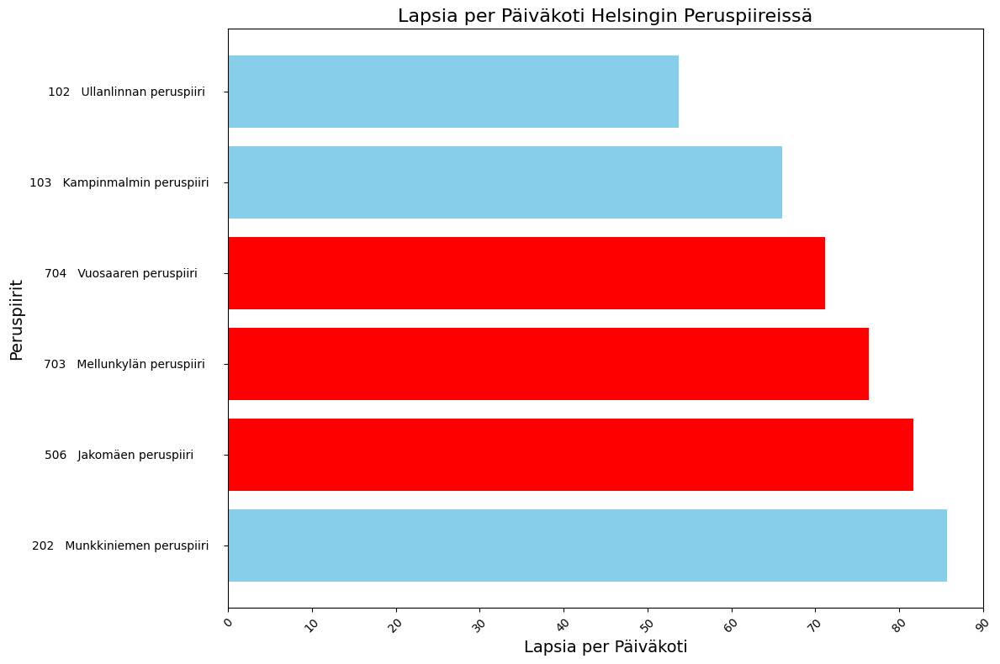

In [ ]:
colors = ['red' if area in ['703   Mellunkylän peruspiiri    ', '506   Jakomäen peruspiiri       ','704   Vuosaaren peruspiiri      '] else 'skyblue' for area in df_selected['Alue']]

plt.figure(figsize=(12, 8))
plt.barh(df_selected['Alue'], df_selected['Lapsia_per_Päiväkoti'], color=colors)

plt.xlabel('Lapsia per Päiväkoti', fontsize=14)
plt.ylabel('Peruspiirit', fontsize=14)
plt.title('Lapsia per Päiväkoti Helsingin Peruspiireissä', fontsize=16)

plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


## Playgrounds per 1000 Children ("Leikkipuistoja per 1000 lasta")
### The number of playgrounds relative to the child population (ages 0-15) is calculated, indicating recreational opportunities available to children in each district. This metric helps identify areas with potentially insufficient play facilities.

<ipython-input-23-b4385997abd7>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected['Playgrounds_per_Child'] = df_selected['Leikkipuisto'] / (df_selected['0-6-vuotiaat'] + df_selected['7-15-vuotiaat'])*1000


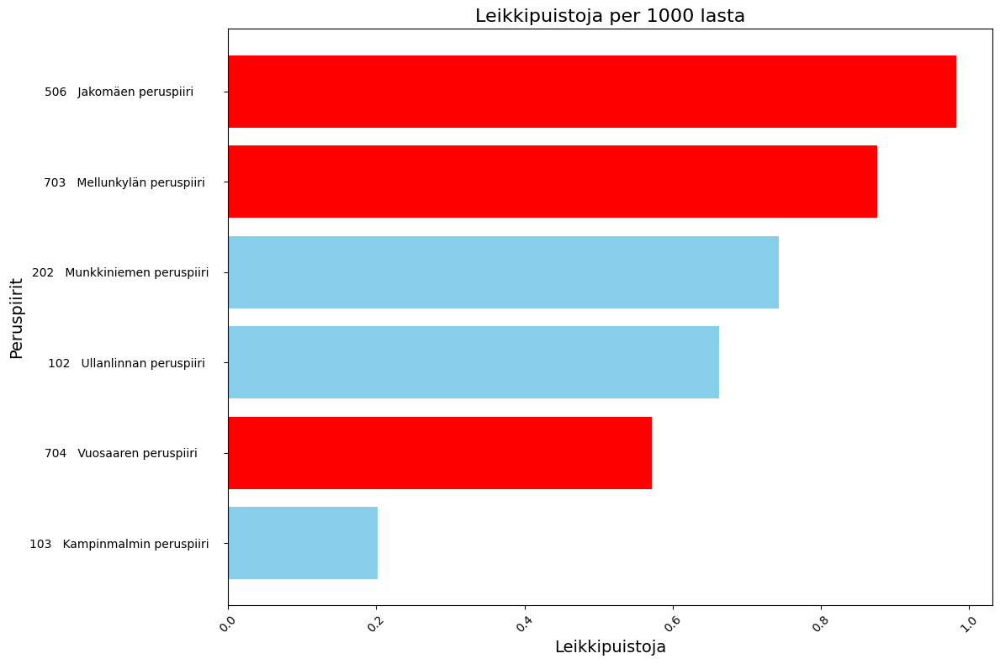

In [ ]:
highlighted_areas = ['703   Mellunkylän peruspiiri    ', '506   Jakomäen peruspiiri       ', '704   Vuosaaren peruspiiri      ']
colors = ['red' if area in highlighted_areas else 'skyblue' for area in df_filtered_sorted_playgrounds['Alue']]

# Calculate the number of Leikkipuisto per person (Leikkipuisto per Asukkaat yht)
df_selected['Playgrounds_per_Child'] = df_selected['Leikkipuisto'] / (df_selected['0-6-vuotiaat'] + df_selected['7-15-vuotiaat'])*1000
# Sort the DataFrame by 'Playgrounds_per_Person' in ascending order
df_filtered_sorted_playgrounds = df_selected.sort_values(by='Playgrounds_per_Child', ascending=True)

# Plot the data
plt.figure(figsize=(12, 8))
plt.barh(df_filtered_sorted_playgrounds['Alue'], df_filtered_sorted_playgrounds['Playgrounds_per_Child'], color=colors)
# Add labels and title
plt.xlabel('Leikkipuistoja', fontsize=14)
plt.ylabel('Peruspiirit', fontsize=14)
plt.title('Leikkipuistoja per 1000 lasta', fontsize=16)

# Rotate the x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


## Sports Facilities per 1000 Residents ("Urheilumahdollisuudet per 1000 ihmistä")
### The availability of sports and recreational facilities, including swimming halls, sports halls, ball fields, and beaches, is normalized per 1000 residents to assess physical activity infrastructure.

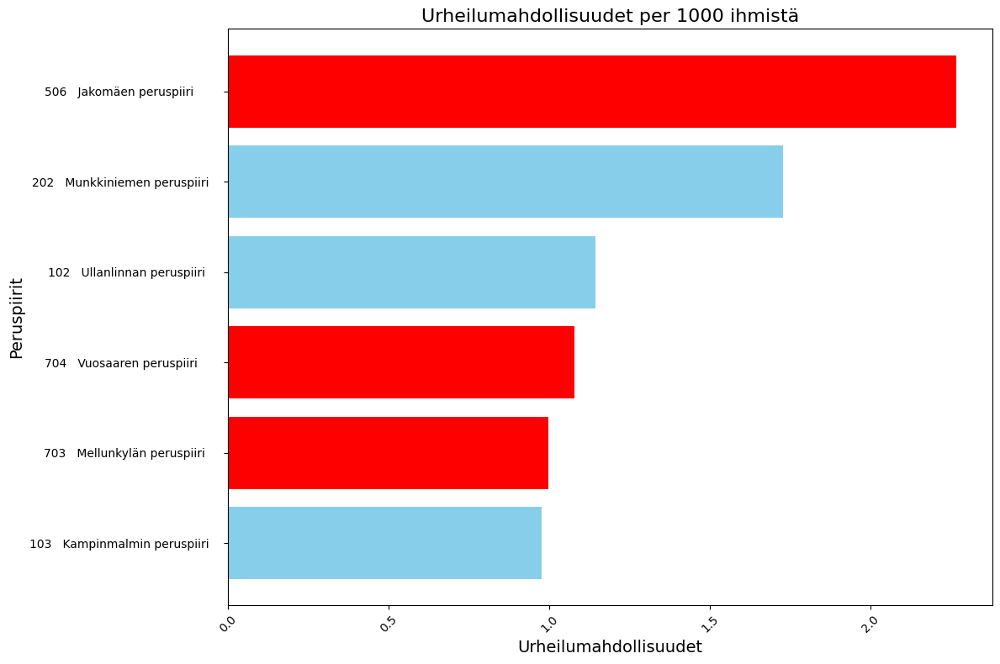

In [ ]:
import matplotlib.pyplot as plt

# Calculate the total recreational facilities per person
df_selected['Total_Recreation_per_Person'] = (
    df_selected['Uimahalli'] +
    df_selected['Liikuntasalit ja -hallit'] +
    df_selected['Pallokentät'] +
    df_selected['Uimaranta, kpl']
) / df_selected['Asukkaat yht']*1000

# Sort the DataFrame by 'Total_Recreation_per_Person' in ascending order
df_filtered_sorted = df_selected.sort_values(by='Total_Recreation_per_Person', ascending=True)

# Define colors for specific areas of interest
highlighted_areas = ['703   Mellunkylän peruspiiri    ', '506   Jakomäen peruspiiri       ', '704   Vuosaaren peruspiiri      ']
colors = ['red' if area in highlighted_areas else 'skyblue' for area in df_filtered_sorted['Alue']]

# Plot the data
plt.figure(figsize=(12, 8))
plt.barh(df_filtered_sorted['Alue'], df_filtered_sorted['Total_Recreation_per_Person'], color=colors)

# Add labels and title
plt.xlabel('Urheilumahdollisuudet', fontsize=14)
plt.ylabel('Peruspiirit', fontsize=14)
plt.title('Urheilumahdollisuudet per 1000 ihmistä', fontsize=16)

# Rotate the x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


## Grocery Stores per 1000 Residents ("Päivittäistavarakauppojen määrä per 1000 ihmistä")
### The density of daily grocery stores in relation to the population size is analyzed to understand food accessibility and commercial service levels in each district.

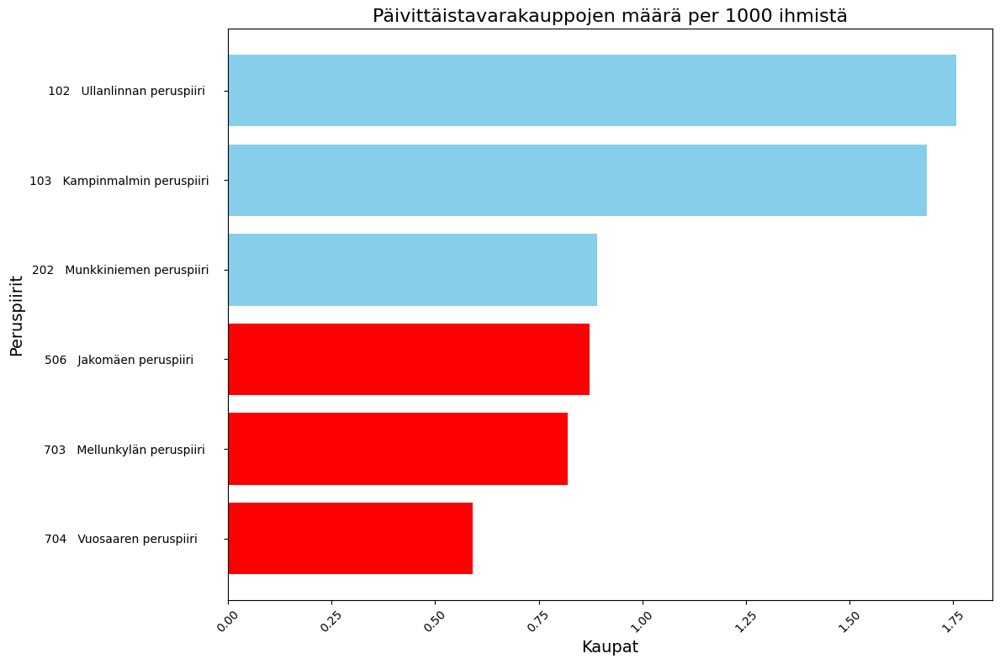

In [ ]:
# Calculate the number of Päivittäistavarakaupat per person (Päivittäistavarakaupat per Asukkaat yht)
df_selected['Stores_per_Person'] = df_selected['Päivittäistavarakaupat'] / df_selected['Asukkaat yht']*1000

# Sort the DataFrame by 'Stores_per_Person' in ascending order
df_filtered_sorted_stores = df_selected.sort_values(by='Stores_per_Person', ascending=True)
colors = ['red' if area in ['703   Mellunkylän peruspiiri    ', '506   Jakomäen peruspiiri       ','704   Vuosaaren peruspiiri      '] else 'skyblue' for area in df_filtered_sorted_stores['Alue']]

# Plot the data
plt.figure(figsize=(12, 8))
plt.barh(df_filtered_sorted_stores['Alue'], df_filtered_sorted_stores['Stores_per_Person'], color=colors)

# Add labels and title
plt.xlabel('Päivittäistavarakaupat', fontsize=14)
plt.ylabel('Peruspiirit', fontsize=14)
plt.title('Päivittäistavarakauppojen määrä per 1000 ihmistä', fontsize=16)

# Rotate the x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


## Pharmacies per 10,000 Residents ("Apteekkien määrä per 10000 asukasta")
### This metric measures healthcare service availability by calculating the number of pharmacies relative to the population, highlighting access to medication and healthcare support.

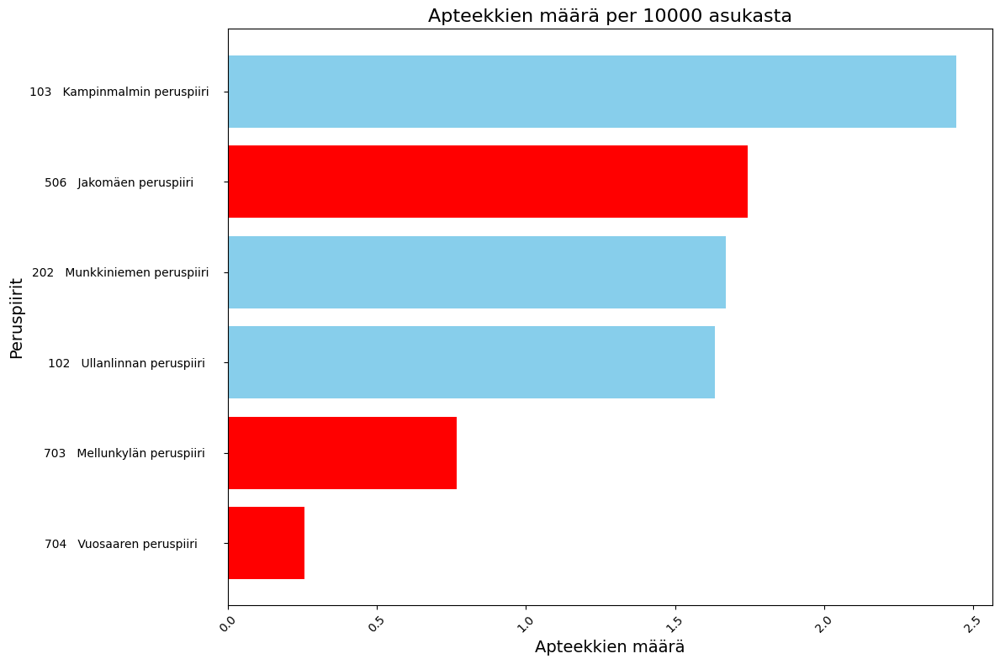

In [ ]:
# Calculate the number of Apteekki per person (Apteekki per Asukkaat yht)
df_selected['Pharmacies_per_Person'] = df_selected['Apteekki'] / df_selected['Asukkaat yht']*10000

# Sort the DataFrame by 'Pharmacies_per_Person' in ascending order
df_filtered_sorted_pharmacies = df_selected.sort_values(by='Pharmacies_per_Person', ascending=True)
colors = ['red' if area in ['703   Mellunkylän peruspiiri    ', '506   Jakomäen peruspiiri       ','704   Vuosaaren peruspiiri      '] else 'skyblue' for area in df_filtered_sorted_pharmacies['Alue']]

# Plot the data
plt.figure(figsize=(12, 8))
plt.barh(df_filtered_sorted_pharmacies['Alue'], df_filtered_sorted_pharmacies['Pharmacies_per_Person'], color=colors)

# Add labels and title
plt.xlabel('Apteekkien määrä', fontsize=14)
plt.ylabel('Peruspiirit', fontsize=14)
plt.title('Apteekkien määrä per 10000 asukasta', fontsize=16)

# Rotate the x-axis labels for better readability if necessary
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


## Alko Stores per 10,000 Residents ("Alkoja per 10000 ihmistä")
### The density of Alko stores (state-run alcohol retail shops) is assessed to understand the distribution of alcohol retail points in relation to district populations.

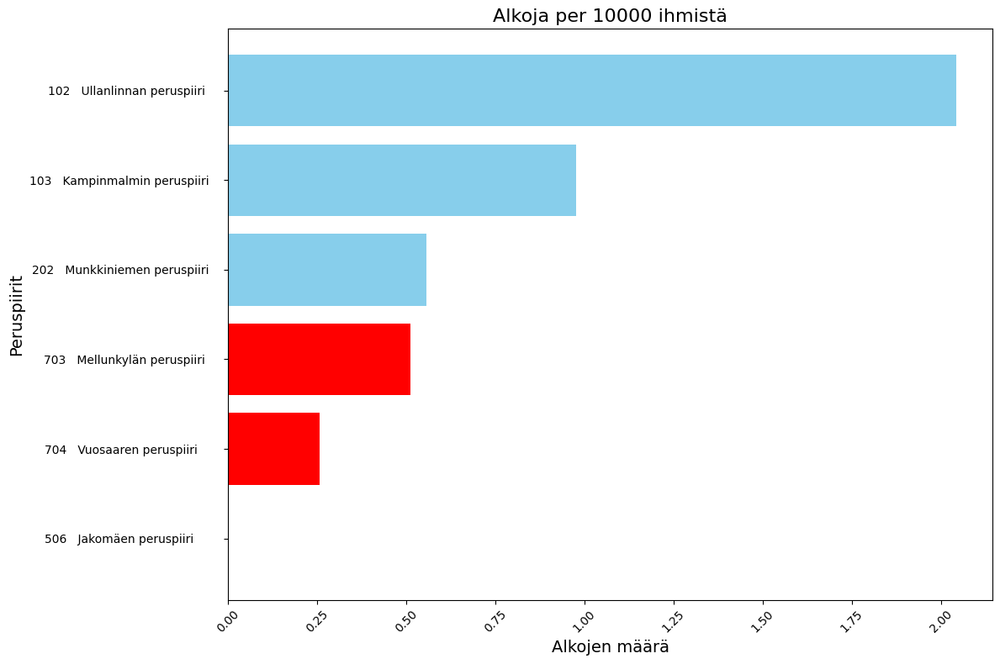

In [ ]:
df_selected['Alko_per_Person'] = df_selected['Alko'] / df_selected['Asukkaat yht']*10000

df_filtered_sorted_alko = df_selected.sort_values(by='Alko_per_Person', ascending=True)
colors = ['red' if area in ['703   Mellunkylän peruspiiri    ', '506   Jakomäen peruspiiri       ','704   Vuosaaren peruspiiri      '] else 'skyblue' for area in df_filtered_sorted_alko['Alue']]

plt.figure(figsize=(12, 8))
plt.barh(df_filtered_sorted_alko['Alue'], df_filtered_sorted_alko['Alko_per_Person'], color=colors)

plt.xlabel('Alkojen määrä', fontsize=14)
plt.ylabel('Peruspiirit', fontsize=14)
plt.title('Alkoja per 10000 ihmistä', fontsize=16)

plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

## Employment Sector Distribution ("Työtyyppit peruspiireissä prosentteina (%)")
### Employment data for selected districts are categorized into major sectors: production, trade, transport, business services, and public services. The relative percentage of jobs in each sector is visualized with stacked bar charts, offering insights into the economic profile and dominant industries per district.

<ipython-input-65-f44851e86d0c>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected_areas[job] = pd.to_numeric(df_selected_areas[job], errors='coerce')
<ipython-input-65-f44851e86d0c>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected_areas['Total Jobs'] = df_selected_areas[job_types].sum(axis=1)


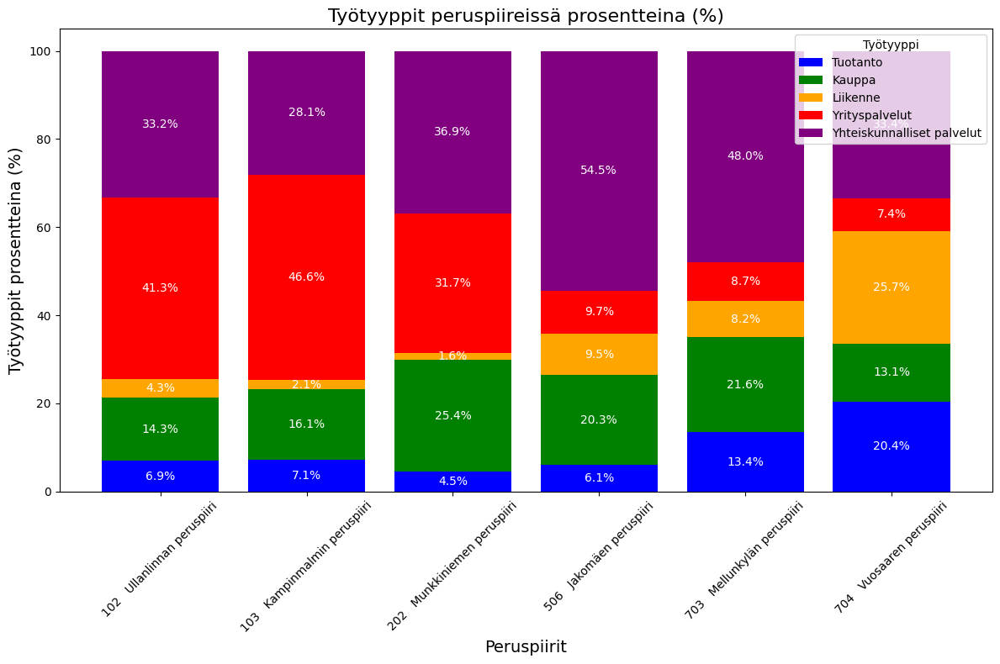

In [ ]:

df_selected_areas = df_jobs[df_jobs['Alue'].isin(selected_areas)]

# Define job type columns
job_types = ['Tuotanto', 'Kauppa', 'Liikenne', 'Yrityspalvelut', 'Yhteiskunnalliset palvelut']

# Convert job type columns to numeric, ensuring proper format
for job in job_types:
    df_selected_areas[job] = pd.to_numeric(df_selected_areas[job], errors='coerce')

# Compute total jobs per area
df_selected_areas['Total Jobs'] = df_selected_areas[job_types].sum(axis=1)

# Compute percentages
data_percentage = (df_selected_areas[job_types].div(df_selected_areas['Total Jobs'], axis=0) * 100).to_numpy().T

# Extract data for plotting
areas = df_selected_areas['Alue']

# Create stacked bar chart
fig, ax = plt.subplots(figsize=(12, 8))

bottom = np.zeros(len(areas))
colors = ['blue', 'green', 'orange', 'red', 'purple']

for i, job in enumerate(job_types):
    bars = ax.bar(areas, data_percentage[i], label=job, bottom=bottom, color=colors[i])
    for bar, percentage in zip(bars, data_percentage[i]):
        if percentage > 0:
            ax.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2,
                    f'{percentage:.1f}%', ha='center', va='center', fontsize=10, color='white')
    bottom += data_percentage[i]

ax.set_xlabel('Peruspiirit', fontsize=14)
ax.set_ylabel('Työtyyppit prosentteina (%)', fontsize=14)
ax.set_title('Työtyyppit peruspiireissä prosentteina (%)', fontsize=16)
ax.legend(title="Työtyyppi")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
